In [4]:
import pandas as pd
import matplotlib.pyplot as plt
import geopandas as gpd
pd.set_option('display.max_columns', None)
from shapely.geometry import Point
import fiona
import math
import plotly.express as px
from thefuzz import fuzz
from thefuzz import process

In [5]:
stores_2022 = pd.read_csv('/srv/data/my_shared_data_folder/rafi/2022_Business_Academic_QCQ_grocery.csv')
stores_2022.drop(['Unnamed: 0'],inplace=True,axis=1)
territories = ['PR', 'FM', 'MP', 'GU', 'VI', 'MH']
stores_2022 = stores_2022.drop(stores_2022[stores_2022['STATE'].isin(territories)].index)

In [7]:
#Filter Grocery stores by SIC (starting with 5411)
#grocery_sic = stores_2022.loc[stores_2022[['PRIMARY SIC CODE']].astype(str).apply(lambda x: x.str.startswith('5411')).any(axis=1)]
#grocery_sic.head()
stores_2022.dtypes

COMPANY                          object
ADDRESS LINE 1                   object
CITY                             object
STATE                            object
ZIPCODE                           int64
ZIP4                            float64
COUNTY CODE                     float64
AREA CODE                         int64
IDCODE                            int64
LOCATION EMPLOYEE SIZE CODE      object
LOCATION SALES VOLUME CODE       object
PRIMARY SIC CODE                  int64
SIC6_DESCRIPTIONS                object
PRIMARY NAICS CODE              float64
NAICS8 DESCRIPTIONS              object
SIC CODE                        float64
SIC6_DESCRIPTIONS (SIC)          object
SIC CODE 1                      float64
SIC6_DESCRIPTIONS (SIC1)         object
SIC CODE 2                      float64
SIC6_DESCRIPTIONS(SIC2)          object
SIC CODE 3                      float64
SIC6_DESCRIPTIONS(SIC3)          object
SIC CODE 4                      float64
SIC6_DESCRIPTIONS(SIC4)          object


In [6]:
pd.reset_option('display.max_rows')


In [4]:
stores_2022.loc[stores_2022["COMPANY"].str.contains("BJ's",na=False)].shape


(0, 53)

In [62]:
costco = stores_2022["COMPANY"]
process.extract("citgo", costco, limit=10)


[('CITGO CONVENIENT FOOD MART', 90, 11),
 ('KEP FOOD CITGO STORE', 90, 19925),
 ('HOP IN CITGO', 90, 26268),
 ('CITGO FOOD SHOP', 90, 52379),
 ('U PAK-IT-CITGO', 90, 57586),
 ('CITGO MARKET', 90, 58783),
 ('COUNTRY STORES CITGO', 90, 73267),
 ("CAUL'S GROCERY CITGO", 90, 94408),
 ('EVERYDAY CITGO', 90, 100458),
 ('EAGLE KETTLE CITGO', 90, 103413)]

In [3]:
pd.set_option('display.max_rows', None)

stores_2022.loc[(stores_2022["COMPANY"].str.contains("WALMART")) & (stores_2022["ADDRESS LINE 1"].str.contains("OLD COUNTRY"))]

,COMPANY,ADDRESS LINE 1,CITY,STATE,ZIPCODE,ZIP4,COUNTY CODE,AREA CODE,IDCODE,LOCATION EMPLOYEE SIZE CODE,LOCATION SALES VOLUME CODE,PRIMARY SIC CODE,SIC6_DESCRIPTIONS,PRIMARY NAICS CODE,NAICS8 DESCRIPTIONS,SIC CODE,SIC6_DESCRIPTIONS (SIC),SIC CODE 1,SIC6_DESCRIPTIONS (SIC1),SIC CODE 2,SIC6_DESCRIPTIONS(SIC2),SIC CODE 3,SIC6_DESCRIPTIONS(SIC3),SIC CODE 4,SIC6_DESCRIPTIONS(SIC4),ARCHIVE VERSION YEAR,YELLOW PAGE CODE,EMPLOYEE SIZE (5) - LOCATION,SALES VOLUME (9) - LOCATION,BUSINESS STATUS CODE,INDUSTRY SPECIFIC FIRST BYTE,YEAR ESTABLISHED,OFFICE SIZE CODE,COMPANY HOLDING STATUS,ABI,SUBSIDIARY NUMBER,PARENT NUMBER,PARENT ACTUAL EMPLOYEE SIZE,PARENT ACTUAL SALES VOLUME,PARENT EMPLOYEE SIZE CODE,PARENT SALES VOLUME CODE,SITE NUMBER,ADDRESS TYPE INDICATOR,POPULATION CODE,CENSUS TRACT,CENSUS BLOCK,LATITUDE,LONGITUDE,MATCH CODE,CBSA CODE,CBSA LEVEL,CSA CODE,FIPS CODE
183022,WALMART GROCERY PICKUP,1890 OLD COUNTRY RD,RIVERHEAD,NY,11901,4453.0,103.0,631,2,A,B,541110,GROCERY PICKUP-CURBSIDE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,3.0,674.0,2,H,NaN,NaN,NaN,749612247,632353488.0,5889993.0,11000.0,572754000.0,K,K,580680635.0,NaN,7,169704.0,6.0,40.924713,-72.712471,P,35620.0,2.0,408.0,36103.0


In [6]:
grocery_t10_22 = grocery_sic.groupby('PARENT NUMBER', dropna=False).size().reset_index(name='COUNT')
grocery_t10_22.sort_values('COUNT', ascending=False, inplace=True)
grocery_t10_22.reset_index(drop=True,inplace=True)

# Create other row
other_row = grocery_t10_22.iloc[11:]
other_column = other_row['COUNT'].sum()

# Remove other rows
grocery_t10_22 = grocery_t10_22.iloc[:11]
grocery_t10_22.loc[len(grocery_t10_22)] = ["Other", other_column]

#grocery_t10_22.reset_index(drop=True, inplace=True)  # Reset index to start from 0

grocery_t10_22['PARENT NUMBER'] = grocery_t10_22['PARENT NUMBER'].astype(str)
grocery_t10_22['Percent'] = grocery_t10_22['COUNT'] / len(grocery_sic) * 100

grocery_t10_22.head()


,PARENT NUMBER,COUNT,Percent
0,nan,77818,49.287773
1,5863311.0,11939,7.561833
2,450720289.0,6814,4.315799
3,5889993.0,4397,2.784938
4,7521503.0,3574,2.263673


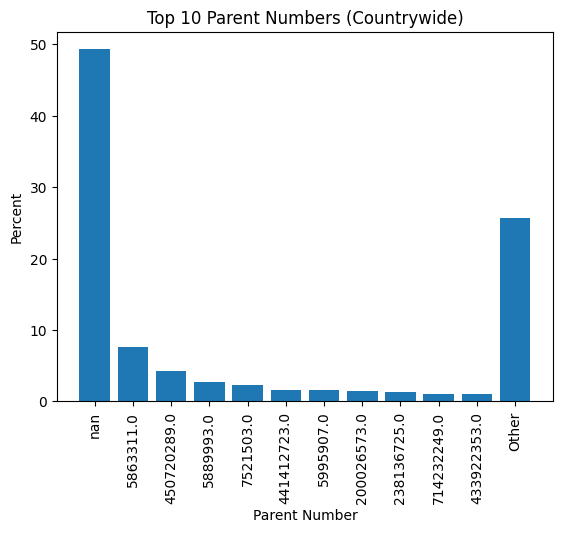

In [7]:
#Top 10 Parent (Country)
plt.bar(grocery_t10_22['PARENT NUMBER'], grocery_t10_22['Percent'])
plt.xlabel('Parent Number')
plt.ylabel('Percent')
plt.title('Top 10 Parent Numbers (Countrywide)')
plt.xticks(rotation=90)
plt.show()

In [8]:
grocery_sic['GEOMETRY'] = [Point(xy) for xy in zip(grocery_sic.LONGITUDE, grocery_sic.LATITUDE)]
grocery22_gdf = gpd.GeoDataFrame(grocery_sic, geometry='GEOMETRY')
grocery22_gdf.set_crs('epsg:4326', inplace=True)  

/tmp/ipykernel_899569/140022936.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  grocery_sic['GEOMETRY'] = [Point(xy) for xy in zip(grocery_sic.LONGITUDE, grocery_sic.LATITUDE)]


,COMPANY,ADDRESS LINE 1,CITY,STATE,ZIPCODE,ZIP4,COUNTY CODE,AREA CODE,IDCODE,LOCATION EMPLOYEE SIZE CODE,LOCATION SALES VOLUME CODE,PRIMARY SIC CODE,SIC6_DESCRIPTIONS,PRIMARY NAICS CODE,NAICS8 DESCRIPTIONS,SIC CODE,SIC6_DESCRIPTIONS (SIC),SIC CODE 1,SIC6_DESCRIPTIONS (SIC1),SIC CODE 2,SIC6_DESCRIPTIONS(SIC2),SIC CODE 3,SIC6_DESCRIPTIONS(SIC3),SIC CODE 4,SIC6_DESCRIPTIONS(SIC4),ARCHIVE VERSION YEAR,YELLOW PAGE CODE,EMPLOYEE SIZE (5) - LOCATION,SALES VOLUME (9) - LOCATION,BUSINESS STATUS CODE,INDUSTRY SPECIFIC FIRST BYTE,YEAR ESTABLISHED,OFFICE SIZE CODE,COMPANY HOLDING STATUS,ABI,SUBSIDIARY NUMBER,PARENT NUMBER,PARENT ACTUAL EMPLOYEE SIZE,PARENT ACTUAL SALES VOLUME,PARENT EMPLOYEE SIZE CODE,PARENT SALES VOLUME CODE,SITE NUMBER,ADDRESS TYPE INDICATOR,POPULATION CODE,CENSUS TRACT,CENSUS BLOCK,LATITUDE,LONGITUDE,MATCH CODE,CBSA CODE,CBSA LEVEL,CSA CODE,FIPS CODE,GEOMETRY
0,GOMART,55 POSTAL PLZ,MORGANTOWN,WV,26508,7005.0,61.0,304,2,C,C,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,554101.0,SERVICE STATIONS-GASOLINE & OIL,554110.0,ALTERNATIVE FUELS,NaN,NaN,NaN,NaN,NaN,NaN,2022,21303.0,13.0,2482.0,2,NaN,NaN,NaN,NaN,998372387,NaN,124929449.0,50.0,389500.0,E,I,998372387.0,NaN,7,11000.0,3.0,39.594376,-79.954437,P,34060.0,2.0,390.0,54061.0,POINT (-79.95444 39.59438)
1,7-ELEVEN,485 E MAIN ST,EL CENTRO,CA,92243,2619.0,25.0,760,2,B,C,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,554101.0,SERVICE STATIONS-GASOLINE & OIL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,6.0,1273.0,2,W,NaN,NaN,NaN,495660326,NaN,5863311.0,800.0,1272634.0,H,K,495660326.0,NaN,7,11400.0,3.0,32.792679,-115.536058,0,20940.0,2.0,0.0,6025.0,POINT (-115.53606 32.79268)
2,EL SOL MARKET,110 W MAIN ST,WESTMORLAND,CA,92281,NaN,25.0,760,2,B,C,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,5.0,1061.0,9,NaN,NaN,NaN,NaN,519605455,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3,10200.0,1.0,33.051800,-115.581800,X,20940.0,2.0,0.0,6025.0,POINT (-115.58180 33.05180)
3,COOL SPRINGS GROCERY,241 WILDWOOD ST,MORGANTOWN,WV,26505,3141.0,61.0,304,2,A,A,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,2.0,382.0,9,NaN,NaN,NaN,NaN,817953730,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7,10400.0,4.0,39.652885,-79.986398,P,34060.0,2.0,390.0,54061.0,POINT (-79.98640 39.65288)
4,CIRCLE K,123 E MAIN ST,WESTMORLAND,CA,92281,NaN,25.0,760,2,B,C,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,554101.0,SERVICE STATIONS-GASOLINE & OIL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,6.0,1273.0,2,F,NaN,NaN,NaN,855113817,NaN,450720289.0,650.0,4981020.0,H,J,NaN,NaN,3,10200.0,1.0,33.051800,-115.581800,X,20940.0,2.0,0.0,6025.0,POINT (-115.58180 33.05180)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203497,T-MART,103 SUNRISE DR,SUNRISE BEACH,TX,78643,9287.0,299.0,325,2,A,A,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,343201.0,PLUMBING FIXTURES & SUPPLIES-MFRS,572222.0,PUMPS-RETAIL,508444.0,PUMPS (WHLS),525104.0,HARDWARE-RETAIL,594131.0,FISHING TACKLE-DEALERS,2022,NaN,2.0,441.0,9,NaN,NaN,NaN,NaN,880617683,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5,970300.0,1.0,30.593381,-98.425843,P,0.0,NaN,0.0,48299.0,POINT (-98.42584 30.59338)
203498,H-E-B,1434 W WELLS BRANCH PKWY,PFLUGERVILLE,TX,78660,3153.0,453.0,512,2,G,H,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,554101.0,SERVICE STATIONS-GASOLINE & OIL,729954.0,VEHICLE & DRIVERS LICENSING SERVICES,581208.0,RESTAURANTS,NaN,NaN,NaN,NaN,2022,39106.0,270.0,71857.0,2,F,NaN,NaN,NaN,403451198,NaN,436443592.0,1000.0,23000000.0,I,K,403451198.0,NaN,8,1840.0,3.0,30.442331,-97.664580,P,12420.0,2.0,0.0,48453.0,POINT (-97.66458 30.44233)
203500,SAC N PAC,2101 N STATE HIGHWAY 123,SAN MA

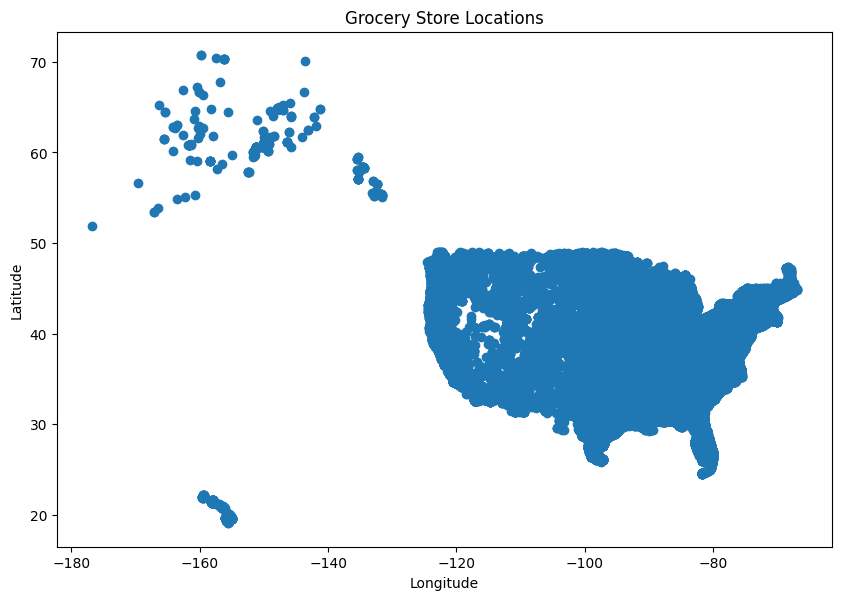

In [9]:
fig, ax = plt.subplots(figsize=(10, 10))
ax.set_aspect('equal')

grocery22_gdf.plot(ax=ax)
ax.set_title('Grocery Store Locations')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
plt.show()


In [10]:
grocery22_gdf["TOP TEN"] = grocery22_gdf['PARENT NUMBER'].apply(lambda x: '5863311.0' in str(x) or '450720289.0' in str(x) or '5889993.0' in str(x)or '7521503.0' in str(x)or '441412723.0' in str(x) or '5995907.0' in str(x) or '200026573.0' in str(x)or '238136725.0' in str(x)or '714232249.0' in str(x) or '433922353.0' in str(x))


In [11]:
grocery22_gdf.loc[:, "INDEPENDENT STORE"] = False
grocery22_gdf.loc[(grocery_sic['PARENT NUMBER'].isna()), 'INDEPENDENT STORE'] = True
grocery22_gdf.head()

,COMPANY,ADDRESS LINE 1,CITY,STATE,ZIPCODE,ZIP4,COUNTY CODE,AREA CODE,IDCODE,LOCATION EMPLOYEE SIZE CODE,LOCATION SALES VOLUME CODE,PRIMARY SIC CODE,SIC6_DESCRIPTIONS,PRIMARY NAICS CODE,NAICS8 DESCRIPTIONS,SIC CODE,SIC6_DESCRIPTIONS (SIC),SIC CODE 1,SIC6_DESCRIPTIONS (SIC1),SIC CODE 2,SIC6_DESCRIPTIONS(SIC2),SIC CODE 3,SIC6_DESCRIPTIONS(SIC3),SIC CODE 4,SIC6_DESCRIPTIONS(SIC4),ARCHIVE VERSION YEAR,YELLOW PAGE CODE,EMPLOYEE SIZE (5) - LOCATION,SALES VOLUME (9) - LOCATION,BUSINESS STATUS CODE,INDUSTRY SPECIFIC FIRST BYTE,YEAR ESTABLISHED,OFFICE SIZE CODE,COMPANY HOLDING STATUS,ABI,SUBSIDIARY NUMBER,PARENT NUMBER,PARENT ACTUAL EMPLOYEE SIZE,PARENT ACTUAL SALES VOLUME,PARENT EMPLOYEE SIZE CODE,PARENT SALES VOLUME CODE,SITE NUMBER,ADDRESS TYPE INDICATOR,POPULATION CODE,CENSUS TRACT,CENSUS BLOCK,LATITUDE,LONGITUDE,MATCH CODE,CBSA CODE,CBSA LEVEL,CSA CODE,FIPS CODE,GEOMETRY,TOP TEN,INDEPENDENT STORE
0,GOMART,55 POSTAL PLZ,MORGANTOWN,WV,26508,7005.0,61.0,304,2,C,C,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,554101.0,SERVICE STATIONS-GASOLINE & OIL,554110.0,ALTERNATIVE FUELS,NaN,NaN,NaN,NaN,NaN,NaN,2022,21303.0,13.0,2482.0,2,NaN,NaN,NaN,NaN,998372387,NaN,124929449.0,50.0,389500.0,E,I,998372387.0,NaN,7,11000.0,3.0,39.594376,-79.954437,P,34060.0,2.0,390.0,54061.0,POINT (-79.95444 39.59438),False,False
1,7-ELEVEN,485 E MAIN ST,EL CENTRO,CA,92243,2619.0,25.0,760,2,B,C,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,554101.0,SERVICE STATIONS-GASOLINE & OIL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,6.0,1273.0,2,W,NaN,NaN,NaN,495660326,NaN,5863311.0,800.0,1272634.0,H,K,495660326.0,NaN,7,11400.0,3.0,32.792679,-115.536058,0,20940.0,2.0,0.0,6025.0,POINT (-115.53606 32.79268),True,False
2,EL SOL MARKET,110 W MAIN ST,WESTMORLAND,CA,92281,NaN,25.0,760,2,B,C,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,5.0,1061.0,9,NaN,NaN,NaN,NaN,519605455,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3,10200.0,1.0,33.051800,-115.581800,X,20940.0,2.0,0.0,6025.0,POINT (-115.58180 33.05180),False,True
3,COOL SPRINGS GROCERY,241 WILDWOOD ST,MORGANTOWN,WV,26505,3141.0,61.0,304,2,A,A,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,2.0,382.0,9,NaN,NaN,NaN,NaN,817953730,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7,10400.0,4.0,39.652885,-79.986398,P,34060.0,2.0,390.0,54061.0,POINT (-79.98640 39.65288),False,True
4,CIRCLE K,123 E MAIN ST,WESTMORLAND,CA,92281,NaN,25.0,760,2,B,C,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,554101.0,SERVICE STATIONS-GASOLINE & OIL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,6.0,1273.0,2,F,NaN,NaN,NaN,855113817,NaN,450720289.0,650.0,4981020.0,H,J,NaN,NaN,3,10200.0,1.0,33.051800,-115.581800,X,20940.0,2.0,0.0,6025.0,POINT (-115.58180 33.05180),True,False


In [12]:
grocery22_gdf.shape

(157885, 56)

In [11]:
grocery22_gdf.drop(["TOP TEN","INDEPENDENT STORE"],inplace=True,axis=1)


In [12]:
def store_type(row):
    '''Based on the country T10 parent number's assigns each company to the group TOP TEN, INDEPENDENT STORE, or OTHER'''
    top_ten = [5863311.0, 450720289.0, 5889993.0, 7521503.0, 441412723.0, 5995907.0, 200026573.0, 238136725.0, 714232249.0, 433922353.0]
    
    parent_num = row['PARENT NUMBER']  
    
    if parent_num in top_ten:
        return 'TOP TEN'
    if math.isnan(parent_num):
        return 'INDEPENDENT STORE'
    
    return 'OTHER'

grocery22_gdf['STORE TYPE'] = grocery22_gdf.apply(store_type, axis=1)
grocery22_gdf.head()

,COMPANY,ADDRESS LINE 1,CITY,STATE,ZIPCODE,ZIP4,COUNTY CODE,AREA CODE,IDCODE,LOCATION EMPLOYEE SIZE CODE,LOCATION SALES VOLUME CODE,PRIMARY SIC CODE,SIC6_DESCRIPTIONS,PRIMARY NAICS CODE,NAICS8 DESCRIPTIONS,SIC CODE,SIC6_DESCRIPTIONS (SIC),SIC CODE 1,SIC6_DESCRIPTIONS (SIC1),SIC CODE 2,SIC6_DESCRIPTIONS(SIC2),SIC CODE 3,SIC6_DESCRIPTIONS(SIC3),SIC CODE 4,SIC6_DESCRIPTIONS(SIC4),ARCHIVE VERSION YEAR,YELLOW PAGE CODE,EMPLOYEE SIZE (5) - LOCATION,SALES VOLUME (9) - LOCATION,BUSINESS STATUS CODE,INDUSTRY SPECIFIC FIRST BYTE,YEAR ESTABLISHED,OFFICE SIZE CODE,COMPANY HOLDING STATUS,ABI,SUBSIDIARY NUMBER,PARENT NUMBER,PARENT ACTUAL EMPLOYEE SIZE,PARENT ACTUAL SALES VOLUME,PARENT EMPLOYEE SIZE CODE,PARENT SALES VOLUME CODE,SITE NUMBER,ADDRESS TYPE INDICATOR,POPULATION CODE,CENSUS TRACT,CENSUS BLOCK,LATITUDE,LONGITUDE,MATCH CODE,CBSA CODE,CBSA LEVEL,CSA CODE,FIPS CODE,GEOMETRY,STORE TYPE
0,GOMART,55 POSTAL PLZ,MORGANTOWN,WV,26508,7005.0,61.0,304,2,C,C,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,554101.0,SERVICE STATIONS-GASOLINE & OIL,554110.0,ALTERNATIVE FUELS,NaN,NaN,NaN,NaN,NaN,NaN,2022,21303.0,13.0,2482.0,2,NaN,NaN,NaN,NaN,998372387,NaN,124929449.0,50.0,389500.0,E,I,998372387.0,NaN,7,11000.0,3.0,39.594376,-79.954437,P,34060.0,2.0,390.0,54061.0,POINT (-79.95444 39.59438),OTHER
1,7-ELEVEN,485 E MAIN ST,EL CENTRO,CA,92243,2619.0,25.0,760,2,B,C,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,554101.0,SERVICE STATIONS-GASOLINE & OIL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,6.0,1273.0,2,W,NaN,NaN,NaN,495660326,NaN,5863311.0,800.0,1272634.0,H,K,495660326.0,NaN,7,11400.0,3.0,32.792679,-115.536058,0,20940.0,2.0,0.0,6025.0,POINT (-115.53606 32.79268),TOP TEN
2,EL SOL MARKET,110 W MAIN ST,WESTMORLAND,CA,92281,NaN,25.0,760,2,B,C,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,5.0,1061.0,9,NaN,NaN,NaN,NaN,519605455,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3,10200.0,1.0,33.051800,-115.581800,X,20940.0,2.0,0.0,6025.0,POINT (-115.58180 33.05180),INDEPENDENT STORE
3,COOL SPRINGS GROCERY,241 WILDWOOD ST,MORGANTOWN,WV,26505,3141.0,61.0,304,2,A,A,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,2.0,382.0,9,NaN,NaN,NaN,NaN,817953730,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7,10400.0,4.0,39.652885,-79.986398,P,34060.0,2.0,390.0,54061.0,POINT (-79.98640 39.65288),INDEPENDENT STORE
4,CIRCLE K,123 E MAIN ST,WESTMORLAND,CA,92281,NaN,25.0,760,2,B,C,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,554101.0,SERVICE STATIONS-GASOLINE & OIL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,6.0,1273.0,2,F,NaN,NaN,NaN,855113817,NaN,450720289.0,650.0,4981020.0,H,J,NaN,NaN,3,10200.0,1.0,33.051800,-115.581800,X,20940.0,2.0,0.0,6025.0,POINT (-115.58180 33.05180),TOP TEN


In [13]:
store_type = grocery22_gdf.groupby("STORE TYPE").count()[["COMPANY"]].reset_index().rename(columns={"COMPANY": "COUNT"})
store_type.head()

,STORE TYPE,COUNT
0,INDEPENDENT STORE,77810
1,OTHER,40514
2,TOP TEN,39553


In [14]:
grocery22_gdf[grocery22_gdf['COMPANY'].isna()] #8 companies with no name (option would be to drop those rows)

,COMPANY,ADDRESS LINE 1,CITY,STATE,ZIPCODE,ZIP4,COUNTY CODE,AREA CODE,IDCODE,LOCATION EMPLOYEE SIZE CODE,LOCATION SALES VOLUME CODE,PRIMARY SIC CODE,SIC6_DESCRIPTIONS,PRIMARY NAICS CODE,NAICS8 DESCRIPTIONS,SIC CODE,SIC6_DESCRIPTIONS (SIC),SIC CODE 1,SIC6_DESCRIPTIONS (SIC1),SIC CODE 2,SIC6_DESCRIPTIONS(SIC2),SIC CODE 3,SIC6_DESCRIPTIONS(SIC3),SIC CODE 4,SIC6_DESCRIPTIONS(SIC4),ARCHIVE VERSION YEAR,YELLOW PAGE CODE,EMPLOYEE SIZE (5) - LOCATION,SALES VOLUME (9) - LOCATION,BUSINESS STATUS CODE,INDUSTRY SPECIFIC FIRST BYTE,YEAR ESTABLISHED,OFFICE SIZE CODE,COMPANY HOLDING STATUS,ABI,SUBSIDIARY NUMBER,PARENT NUMBER,PARENT ACTUAL EMPLOYEE SIZE,PARENT ACTUAL SALES VOLUME,PARENT EMPLOYEE SIZE CODE,PARENT SALES VOLUME CODE,SITE NUMBER,ADDRESS TYPE INDICATOR,POPULATION CODE,CENSUS TRACT,CENSUS BLOCK,LATITUDE,LONGITUDE,MATCH CODE,CBSA CODE,CBSA LEVEL,CSA CODE,FIPS CODE,GEOMETRY,STORE TYPE
24442,NaN,20207 MCKENNEY HWY,STONY CREEK,VA,23882,2229.0,53.0,804,1,C,C,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,21303.0,15.0,2301.0,9,NaN,NaN,NaN,NaN,436873257,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4,840100.0,1.0,36.945282,-77.555286,P,40060.0,2.0,0.0,51053.0,POINT (-77.55529 36.94528),INDEPENDENT STORE
92875,NaN,1719 KENWOOD DR,SAN ANGELO,TX,76903,8340.0,451.0,325,1,A,B,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,4.0,920.0,9,NaN,NaN,NaN,NaN,735520631,NaN,NaN,NaN,NaN,NaN,NaN,740644536.0,NaN,7,1000.0,3.0,31.443151,-100.446388,P,41660.0,2.0,0.0,48451.0,POINT (-100.44639 31.44315),INDEPENDENT STORE
116742,NaN,1088 N MOONEY BLVD,TULARE,CA,93274,2417.0,107.0,559,1,A,B,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,21303.0,3.0,800.0,9,NaN,NaN,NaN,NaN,436340738,NaN,NaN,NaN,NaN,NaN,NaN,706173656.0,NaN,8,2400.0,4.0,36.225627,-119.312385,P,47300.0,2.0,0.0,6107.0,POINT (-119.31239 36.22563),INDEPENDENT STORE
117185,NaN,1309 E MORGAN ST,MARTINSVILLE,IN,46151,1728.0,109.0,765,1,B,C,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,7.0,1506.0,9,NaN,NaN,NaN,NaN,711091320,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7,510800.0,1.0,39.427550,-86.412768,P,26900.0,2.0,294.0,18109.0,POINT (-86.41277 39.42755),INDEPENDENT STORE
142220,NaN,8111 86TH AVE NW,GIG HARBOR,WA,98332,6712.0,53.0,253,1,A,B,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,3.0,869.0,9,NaN,NaN,NaN,NaN,437012791,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6,72504.0,2.0,47.330921,-122.652858,P,42660.0,2.0,500.0,53053.0,POINT (-122.65286 47.33092),INDEPENDENT STORE
169193,NaN,3220 MAIN ST,BARNSTABLE,MA,2630,1107.0,1.0,774,1,C,C,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,10.0,2449.0,9,NaN,NaN,NaN,NaN,439961064,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3,12200.0,2.0,41.701838,-70.303043,P,12700.0,2.0,148.0,25001.0,POINT (-70.30304 41.70184),INDEPENDENT STORE
174966,NaN,2613 BARRACKS RD,CHARLOTTESVILLE,VA,22901,2120.0,3.0,434,1,B,C,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,5.0,1240.0,9,NaN,NaN,NaN,NaN,438184803,NaN,NaN,NaN,NaN,NaN,NaN,588758961.0,NaN,7,10800.0,4.0,38.062967,-78.512013,P,16820.0,2.0,0.0,51003.0,POINT (-78.51201 38.06297),INDEPENDENT STORE
187145,NaN,610 MACON ST,MCDONOUGH,GA,30253,3532.0,151.0,770,1,A,B,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,3.0,622.0,9,NaN,NaN,NaN,NaN,428062648,NaN,NaN,NaN,NaN,NaN,NaN,712006695.0,NaN,7,70304.0,2.0,33.431323,-84.144972,P,12060.0,2.0,122.0,13151.0,POINT (-84.14497 33.43132),INDEPENDENT STORE


In [15]:
#Subsects IL
il = grocery22_gdf.loc[grocery22_gdf["STATE"] == 'IL', :]
il = il.drop(["GEOMETRY","STORE TYPE"],axis=1)

def store_type(row):
    '''Based on the country T10 parent number's assigns each company to the group TOP TEN, INDEPENDENT STORE, or OTHER'''
    top_ten_il = [441412723.0, 5863311.0, 450720289.0, 200026573.0, 5995907.0, 5889993.0, 7521503.0, 1490291.0, 723360636.0, 5644232.0]
    
    parent_num = row['PARENT NUMBER']  
    
    if parent_num in top_ten_il:
        return 'TOP TEN (IL)'
    if math.isnan(parent_num):
        return 'INDEPENDENT STORE (IL)'
    
    return 'OTHER (IL)'
il['STORE TYPE'] = il.apply(store_type, axis=1)
il.head()

,COMPANY,ADDRESS LINE 1,CITY,STATE,ZIPCODE,ZIP4,COUNTY CODE,AREA CODE,IDCODE,LOCATION EMPLOYEE SIZE CODE,LOCATION SALES VOLUME CODE,PRIMARY SIC CODE,SIC6_DESCRIPTIONS,PRIMARY NAICS CODE,NAICS8 DESCRIPTIONS,SIC CODE,SIC6_DESCRIPTIONS (SIC),SIC CODE 1,SIC6_DESCRIPTIONS (SIC1),SIC CODE 2,SIC6_DESCRIPTIONS(SIC2),SIC CODE 3,SIC6_DESCRIPTIONS(SIC3),SIC CODE 4,SIC6_DESCRIPTIONS(SIC4),ARCHIVE VERSION YEAR,YELLOW PAGE CODE,EMPLOYEE SIZE (5) - LOCATION,SALES VOLUME (9) - LOCATION,BUSINESS STATUS CODE,INDUSTRY SPECIFIC FIRST BYTE,YEAR ESTABLISHED,OFFICE SIZE CODE,COMPANY HOLDING STATUS,ABI,SUBSIDIARY NUMBER,PARENT NUMBER,PARENT ACTUAL EMPLOYEE SIZE,PARENT ACTUAL SALES VOLUME,PARENT EMPLOYEE SIZE CODE,PARENT SALES VOLUME CODE,SITE NUMBER,ADDRESS TYPE INDICATOR,POPULATION CODE,CENSUS TRACT,CENSUS BLOCK,LATITUDE,LONGITUDE,MATCH CODE,CBSA CODE,CBSA LEVEL,CSA CODE,FIPS CODE,STORE TYPE
13,KROGER,301 E MCKINLEY RD,OTTAWA,IL,61350,4805.0,99.0,815,2,E,F,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,70.0,14158.0,2,P,NaN,NaN,NaN,152123287,NaN,7521503.0,1200.0,137888000.0,I,I,152123287.0,NaN,7,963500.0,1.0,41.323858,-88.836271,P,36837.0,1.0,176.0,17099.0,TOP TEN (IL)
86,CIRCLE K,290 MAIN ST,MARSEILLES,IL,61341,NaN,99.0,815,2,C,C,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,554101.0,SERVICE STATIONS-GASOLINE & OIL,554110.0,ALTERNATIVE FUELS,NaN,NaN,NaN,NaN,NaN,NaN,2022,21303.0,11.0,2225.0,2,F,NaN,NaN,NaN,312709629,NaN,450720289.0,650.0,4981020.0,H,J,NaN,NaN,5,962400.0,2.0,41.333000,-88.701000,X,36837.0,1.0,176.0,17099.0,TOP TEN (IL)
199,SPRING VALLEY SUPERMARKET,117 S SPALDING ST,SPRING VALLEY,IL,61362,2097.0,11.0,815,2,E,E,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,542107.0,MEAT-RETAIL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,60.0,8908.0,9,NaN,NaN,NaN,NaN,2994101,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5,965200.0,2.0,41.323951,-89.199282,P,36837.0,1.0,176.0,17011.0,INDEPENDENT STORE (IL)
238,FREEDOM OIL CO,402 N MAIN ST,TOLUCA,IL,61369,9025.0,123.0,815,2,B,C,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,554101.0,SERVICE STATIONS-GASOLINE & OIL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,7.0,1545.0,2,NaN,NaN,NaN,NaN,308353358,NaN,452637325.0,17.0,52200.0,C,H,NaN,NaN,3,961500.0,2.0,41.005092,-89.133807,P,37900.0,2.0,0.0,17123.0,OTHER (IL)
316,SENECA FOOD MART,271 S MAIN ST,SENECA,IL,61360,9415.0,99.0,815,2,B,C,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,209903.0,FOOD PRODUCTS & MANUFACTURERS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,8.0,1618.0,2,NaN,NaN,NaN,NaN,152142808,NaN,558247.0,75.0,1385280.0,E,K,NaN,NaN,4,963700.0,1.0,41.306622,-88.610207,P,36837.0,1.0,176.0,17099.0,OTHER (IL)


In [16]:
groc_il = il.groupby('PARENT NUMBER', dropna=False).count().reset_index()[['PARENT NUMBER','COMPANY']]
groc_il.sort_values('COMPANY', ascending=False, inplace=True)
groc_il.reset_index(drop=True,inplace=True)

groc_tp10_il = groc_il.iloc[:11]
other_groc = groc_il['COMPANY'].sum() - groc_tp10_il['COMPANY'].sum()

groc_tp10_il.loc[len(groc_tp10_il.index)] = ["Other", other_groc]
groc_tp10_il['PARENT NUMBER'] = groc_tp10_il['PARENT NUMBER'].astype(str)
groc_tp10_il.loc[:, 'Percent'] = groc_tp10_il.loc[:, 'COMPANY'] / len(il) * 100
groc_tp10_il.rename(columns={"COMPANY":"COUNT"})

/tmp/ipykernel_880357/2855846445.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  groc_tp10_il.loc[len(groc_tp10_il.index)] = ["Other", other_groc]
/tmp/ipykernel_880357/2855846445.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  groc_tp10_il['PARENT NUMBER'] = groc_tp10_il['PARENT NUMBER'].astype(str)
/tmp/ipykernel_880357/2855846445.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas

,PARENT NUMBER,COUNT,Percent
0,nan,2236,43.074552
1,441412723.0,525,10.113658
2,5863311.0,446,8.591793
3,450720289.0,329,6.337893
4,200026573.0,221,4.257369
5,5995907.0,189,3.640917
6,5889993.0,134,2.581391
7,7521503.0,122,2.350222
8,1490291.0,89,1.714506
9,723360636.0,68,1.309960


In [17]:
#FINDS IL top ten grocery stores. 
groc_il = il.groupby('PARENT NUMBER', dropna=False).agg({'EMPLOYEE SIZE (5) - LOCATION': 'sum',
                                                        'STORE TYPE': 'first'}).reset_index()
groc_il.sort_values('EMPLOYEE SIZE (5) - LOCATION', ascending=False, inplace=True)
groc_il.reset_index()
groc_il.head()

,PARENT NUMBER,EMPLOYEE SIZE (5) - LOCATION,STORE TYPE
7,5995907.0,34245.0,TOP TEN (IL)
78,NaN,17766.0,INDEPENDENT STORE (IL)
8,7521503.0,11193.0,TOP TEN (IL)
4,5644232.0,8702.0,TOP TEN (IL)
39,441412723.0,6156.0,TOP TEN (IL)


### CLEANING

In [18]:
country_independent = grocery22_gdf.loc[grocery22_gdf["STORE TYPE"] == "INDEPENDENT STORE", :]
country_independent_sorted = country_independent.sort_values(by=['EMPLOYEE SIZE (5) - LOCATION'], ascending=False)
country_independent50 = country_independent_sorted.iloc[:50, :]
country_independent50.head()
#top 10 parent compnaies in the country 
# 1) 5863311.0 = parent company = Seven & I holdings 
# 2) 450720289.0 = parent company(s) = Alimentation Couche-Tard, Convenience Retail Asia
# 3) 5889993.0 = parent company = Walmart 
# 4) 7521503.0 = parent company = Kroger 
#5) 441412723.0 = parent company(s)= Rutters Holding Inc, CHR Corporation 
#6) 5995907.0 = parent company = Albertson, American stores 3
#7) 200026573.0 = parent company = Albrecht Discounts(aldi)
#8) not showing data Ahold Delhaize
#9) 714232249.0 = parentt company = Clark Enterprises Inc
#10) 433922353.0 = parent compnay = Murphy Oil Corporation USA 

,COMPANY,ADDRESS LINE 1,CITY,STATE,ZIPCODE,ZIP4,COUNTY CODE,AREA CODE,IDCODE,LOCATION EMPLOYEE SIZE CODE,LOCATION SALES VOLUME CODE,PRIMARY SIC CODE,SIC6_DESCRIPTIONS,PRIMARY NAICS CODE,NAICS8 DESCRIPTIONS,SIC CODE,SIC6_DESCRIPTIONS (SIC),SIC CODE 1,SIC6_DESCRIPTIONS (SIC1),SIC CODE 2,SIC6_DESCRIPTIONS(SIC2),SIC CODE 3,SIC6_DESCRIPTIONS(SIC3),SIC CODE 4,SIC6_DESCRIPTIONS(SIC4),ARCHIVE VERSION YEAR,YELLOW PAGE CODE,EMPLOYEE SIZE (5) - LOCATION,SALES VOLUME (9) - LOCATION,BUSINESS STATUS CODE,INDUSTRY SPECIFIC FIRST BYTE,YEAR ESTABLISHED,OFFICE SIZE CODE,COMPANY HOLDING STATUS,ABI,SUBSIDIARY NUMBER,PARENT NUMBER,PARENT ACTUAL EMPLOYEE SIZE,PARENT ACTUAL SALES VOLUME,PARENT EMPLOYEE SIZE CODE,PARENT SALES VOLUME CODE,SITE NUMBER,ADDRESS TYPE INDICATOR,POPULATION CODE,CENSUS TRACT,CENSUS BLOCK,LATITUDE,LONGITUDE,MATCH CODE,CBSA CODE,CBSA LEVEL,CSA CODE,FIPS CODE,GEOMETRY,STORE TYPE
141700,LA RAZA MARKET,705 23RD ST,RICHMOND,CA,94804,1446.0,13.0,510,2,I,J,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,2000.0,568730.0,9,NaN,NaN,NaN,NaN,928137330,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7,375000.0,1.0,37.942235,-122.347799,P,41860.0,2.0,488.0,6013.0,POINT (-122.34780 37.94223),INDEPENDENT STORE
43408,AFFILIATEDFOODS INC,1401 W FARMERS AVE,AMARILLO,TX,79118,6134.0,381.0,806,2,I,I,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,514105.0,GROCERS-WHOLESALE,514801.0,FRUITS & VEGETABLES-WHOLESALE,514704.0,MEAT-WHOLESALE,514961.0,DISTRIBUTOR-GROCERIES (WHLS),514101.0,FOOD PRODUCTS (WHLS),2022,39106.0,2000.0,466925.0,9,NaN,1945.0,NaN,NaN,668815426,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6,22002.0,1.0,35.133996,-101.850992,P,11100.0,2.0,108.0,48381.0,POINT (-101.85099 35.13400),INDEPENDENT STORE
4854,GENUARDI'S FAMILY MARKET LP,20427 N 27TH AVE # 4501,PHOENIX,AZ,85027,3241.0,13.0,623,2,I,I,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,1500.0,343523.0,9,NaN,NaN,NaN,NaN,414622376,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7,614600.0,5.0,33.673002,-112.115248,P,38060.0,2.0,429.0,4013.0,POINT (-112.11525 33.67300),INDEPENDENT STORE
40083,SSP PARTNERS,708 N US HIGHWAY 77,SCHULENBURG,TX,78956,5638.0,149.0,979,2,H,I,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,600.0,100839.0,9,NaN,NaN,NaN,NaN,695103747,NaN,NaN,NaN,NaN,NaN,NaN,695103747.0,NaN,5,970600.0,3.0,29.694457,-96.903156,P,0.0,NaN,0.0,48149.0,POINT (-96.90316 29.69446),INDEPENDENT STORE
170019,ZABAR'S GOURMET CATERING,2245 BROADWAY,NEW YORK,NY,10024,5899.0,61.0,212,2,H,G,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,581212.0,CATERERS,571929.0,HOUSEWARES-RETAIL,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,500.0,41255.0,9,NaN,1934.0,NaN,NaN,414520044,NaN,NaN,NaN,NaN,NaN,NaN,414520044.0,NaN,8,16700.0,3.0,40.784844,-73.979446,P,35620.0,2.0,408.0,36061.0,POINT (-73.97945 40.78484),INDEPENDENT STORE


In [19]:
top50 = country_independent50[["COMPANY"]]
top50.duplicated()
top50.iloc[20]
top50.loc[top50.COMPANY=="EL SOL MARKET"]

,COMPANY


In [15]:
#Ahold Delhaize owned supermarkets/companies
ahold = ["Bottom Dollar Food",
    "Food Lion",
    "FreshDirect",
    "Giant",
    "Giant Food",
    "Hannaford",
    "Stop & Shop",
    "Peapod",
    "Bfresh",
    "Eastside Marketplace",]

#WALMART owned supermarkets/companies
walmart = ["WALMART","SAM'S CLUB"]

#Krogers owned supermarkets/companies
kroger = ["Baker's",
    "City Market",
    "Dillons",
    "Food 4 Less",
    "Foods Co.",
    "Fred Meyer",
    "Fry's",
    "Gerbes",
    "Harris Teeter",
    "JayC",
    "King Soopers",
    "Kroger",
    "Mariano's",
    "Metro Market",
    "Pay Less",
    "Pick 'n Save",
    "QFC",
    "Ralphs",
    "Ruler Foods",
    "Smith's",]

# Albertsons owned supermarkets/companies
albertsons= ["Acme Markets",
    "Albertsons",
    "Albertsons Market",
    "Amigos",
    "Andronico's",
    "Balducci's",
    "Carrs",
    "Haggen",
    "Jewel-Osco",
    "Kings Food Markets",
    "Lucky",
    "Market Street",
    "Pak 'n Save",
    "Pavilions",
    "Randalls",
    "Safewa",
    "Shaw's",
    "Star Market",
    "Tom Thumb",
    "United Supermarkets",
    "Vons",
    "Buttrey Food and Drug",
    "Max Food and Drug",
    "Max Foods",
    "Skagg's Albertsons",
    "Super Saver",]

#Costco owned supermarkets/companies
costco = ["Costco"]

In [19]:
parent = costco
companies = stores_2022["COMPANY"]

matches = []
for item in parent:
    for result in process.extract(item, companies, limit=len(parent)+1):
        store = result[0]
        score = result[1]
        if score >= 77 and store not in matches:
            matches.append(store)

print(matches)




['COSTCO DELI']


In [32]:
#String matched brands owned by Walmart:
walmart_string = ['WALMART GROCERY PICKUP', 'WALMART GROCERY PKUP-DELIVERY', "SAM'S CLUB DELI"]

#String matched brands owned by Ahold Delhaize:
ahold_string = ['BOTTOM DOLLAR', 'DOLLAR DOLLAR', 'FOOD', 'FOOD 4 LESS', 'FOOD LION', 'FRESH DIRECT', 'REC', 'FRESH', 'H & H', 'S & S', 'FRESHII', 'GIANT', 'GIANT EAGLE', 'GIANT EAGLE FLORAL', 'GIANT FOOD', 'HANNAFORD', 'STOP & SHOP', 'PEA POD', 'BFRESH MARKET', 'REFRESH', 'EASTSIDE MARKETPLACE', 'WESTSIDE MARKETPLACE', 'MARKET', 'E MARKET', 'MARKETPLACE']

#String matched brands owned by Kroger:
kroger_string = ["BAKER'S", 'S & S', 'BAKERS', "BAKER'S GAS & WELD SUPLS INC", "BAKER'S GAS", "BAKER'S MARKET", "BAKER'S PRO FARM LLC", 'BAKER STREET MARKET', "BAKER'S KWIK SHOP", 'CITY MARKET', 'DILLONS', 'FOOD 4 LESS', 'FOODS CO', 'FRED MEYER', "FRY'S FOOD", 'GERBES SUPER MARKET', 'GERBES SUPER MARKETS', 'GE', 'GERBES SUPERMARKET', 'HARRIS TEETER', 'JAYC', "JAYCEE'S", 'JAYCON', 'CITY-RALEIGH-JAYCEE PARK-CMNTY', 'JAYCE MINIMARKET', 'NAY & JAY', 'KING SOOPERS', 'KROGER', "MARIANO'S", 'METRO MARKET', 'METRO MINI MARKET', 'MARKET MARKET', 'PAY LESS LIQUORS', 'PAY LESS SUPER MARKETS', 'PAY LESS GAS & FOOD', 'PAY LESS IGA', 'FOOD FOR LESS', 'FAR LESS FOOD MARKET', 'MORE FOR LESS', 'PRICE LESS FOODS', 'COST LESS FOODS CO', "PICK'N SAVE", 'QFC', 'RALPHS', 'RULER FOODS', "SMITH'S"]

#String matched brands owned by Costco
costco_string = ["COSTCO DELI"]

In [30]:
#KROGERS FINAL
kroger_clean = ["BAKER'S",
 'BAKERS', 
 'CITY MARKET',
 'DILLONS',
 'FOOD 4 LESS', 
 'FOODS CO', 
 'FRED MEYER', 
 "FRY'S FOOD",
 'GERBES SUPER MARKET',  
 'GERBES SUPER MARKETS', 
 'GERBES SUPERMARKET', 
 'HARRIS TEETER', 
 'JAYC', 
 'KING SOOPERS',
 'KROGER',
 "MARIANO'S",
 'METRO MARKET', 
 'PAY LESS SUPER MARKETS',
 "PICK'N SAVE", 
 'QFC', 
 'RALPHS', 
 'RULER FOODS', 
 "SMITH'S"]

#Ahold Delhaize FINAL:
ahold_clean = ['BOTTOM DOLLAR',
 'FOOD LION',
 'GIANT',
 'GIANT EAGLE',
 'GIANT FOOD',
 'HANNAFORD',
 'STOP & SHOP',
 'PEA POD',
 'BFRESH MARKET',
 'EASTSIDE MARKETPLACE']

#WALMART FINAL:
walmart_clean = ['WALMART GROCERY PICKUP',
 'WALMART GROCERY PKUP-DELIVERY', 
 "SAM'S CLUB DELI"]

#COSTCO FINAL:
costco_clean = ["COSTCO DELI"]


In [37]:
#Records the removed values from the string matching for each store
kroger_removed = [value for value in kroger_string if value not in kroger_clean]
ahold_removed = [value for value in ahold_string if value not in ahold_clean]
walmart_removed = [value for value in walmart_string if value not in walmart_clean]
costco_removed = [value for value in costco_string if value not in costco_clean]


[]

In [28]:
stores_2022.loc[stores_2022["COMPANY"]=="GERBES SUPER MARKET"]

,COMPANY,ADDRESS LINE 1,CITY,STATE,ZIPCODE,ZIP4,COUNTY CODE,AREA CODE,IDCODE,LOCATION EMPLOYEE SIZE CODE,LOCATION SALES VOLUME CODE,PRIMARY SIC CODE,SIC6_DESCRIPTIONS,PRIMARY NAICS CODE,NAICS8 DESCRIPTIONS,SIC CODE,SIC6_DESCRIPTIONS (SIC),SIC CODE 1,SIC6_DESCRIPTIONS (SIC1),SIC CODE 2,SIC6_DESCRIPTIONS(SIC2),SIC CODE 3,SIC6_DESCRIPTIONS(SIC3),SIC CODE 4,SIC6_DESCRIPTIONS(SIC4),ARCHIVE VERSION YEAR,YELLOW PAGE CODE,EMPLOYEE SIZE (5) - LOCATION,SALES VOLUME (9) - LOCATION,BUSINESS STATUS CODE,INDUSTRY SPECIFIC FIRST BYTE,YEAR ESTABLISHED,OFFICE SIZE CODE,COMPANY HOLDING STATUS,ABI,SUBSIDIARY NUMBER,PARENT NUMBER,PARENT ACTUAL EMPLOYEE SIZE,PARENT ACTUAL SALES VOLUME,PARENT EMPLOYEE SIZE CODE,PARENT SALES VOLUME CODE,SITE NUMBER,ADDRESS TYPE INDICATOR,POPULATION CODE,CENSUS TRACT,CENSUS BLOCK,LATITUDE,LONGITUDE,MATCH CODE,CBSA CODE,CBSA LEVEL,CSA CODE,FIPS CODE
1637,GERBES SUPER MARKET,1159 E US HIGHWAY 54,CAMDENTON,MO,65020,6837.0,29.0,573,2,B,B,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,591205.0,PHARMACIES,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,5.0,894.0,2,NaN,NaN,NaN,NaN,822320024,587079864.0,7521503.0,1200.0,137888000.0,I,I,411307625.0,NaN,6,950400.0,2.0,38.021,-92.729774,P,0.0,NaN,0.0,29029.0


In [38]:
def parent_name(row):
    '''Based on the Companies ownded by the Parent Corp''' 
    companies = row['COMPANY']  
    
    if companies in walmart_clean:
        return 'WALMART'
    if companies in costco_clean:
        return 'COSTCO'
    if companies in ahold_clean:
        return 'AHOLD'
    if companies in kroger_clean:
        return 'KROGER'

stores_2022['PARENT NAME'] = stores_2022.apply(parent_name, axis=1)


In [44]:
#Step 1: filter a dataframe based on parent coporations
parent_companies = ['WALMART', 'COSTCO', 'KROGER', 'AHOLD']
filtered_df = stores_2022[stores_2022['PARENT NAME'].isin(parent_companies)]

# Step 2: Extract the PRIMARY SIC CODES values
primary_sic_codes = filtered_df['PRIMARY SIC CODE']

# Step 3: Get the unique PRIMARY SIC CODES values
unique_sic_codes = primary_sic_codes.unique()

# Print the unique PRIMARY SIC CODES
print(unique_sic_codes)

[541105 541110 541103]


In [59]:



stores_2022.loc[stores_2022["COMPANY"]=="AMIGOS MKT LOS"]

,COMPANY,ADDRESS LINE 1,CITY,STATE,ZIPCODE,ZIP4,COUNTY CODE,AREA CODE,IDCODE,LOCATION EMPLOYEE SIZE CODE,LOCATION SALES VOLUME CODE,PRIMARY SIC CODE,SIC6_DESCRIPTIONS,PRIMARY NAICS CODE,NAICS8 DESCRIPTIONS,SIC CODE,SIC6_DESCRIPTIONS (SIC),SIC CODE 1,SIC6_DESCRIPTIONS (SIC1),SIC CODE 2,SIC6_DESCRIPTIONS(SIC2),SIC CODE 3,SIC6_DESCRIPTIONS(SIC3),SIC CODE 4,SIC6_DESCRIPTIONS(SIC4),ARCHIVE VERSION YEAR,YELLOW PAGE CODE,EMPLOYEE SIZE (5) - LOCATION,SALES VOLUME (9) - LOCATION,BUSINESS STATUS CODE,INDUSTRY SPECIFIC FIRST BYTE,YEAR ESTABLISHED,OFFICE SIZE CODE,COMPANY HOLDING STATUS,ABI,SUBSIDIARY NUMBER,PARENT NUMBER,PARENT ACTUAL EMPLOYEE SIZE,PARENT ACTUAL SALES VOLUME,PARENT EMPLOYEE SIZE CODE,PARENT SALES VOLUME CODE,SITE NUMBER,ADDRESS TYPE INDICATOR,POPULATION CODE,CENSUS TRACT,CENSUS BLOCK,LATITUDE,LONGITUDE,MATCH CODE,CBSA CODE,CBSA LEVEL,CSA CODE,FIPS CODE,PARENT NAME
25723,AMIGOS MKT LOS,4201 UNIVERSITY AVE,SAN DIEGO,CA,92105,1502.0,73.0,619,2,A,B,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,3.0,814.0,9,NaN,NaN,NaN,NaN,672146081,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8,2402.0,1.0,32.749399,-117.10426,P,41740.0,2.0,0.0,6073.0,None


### PLOTLY MAPPING

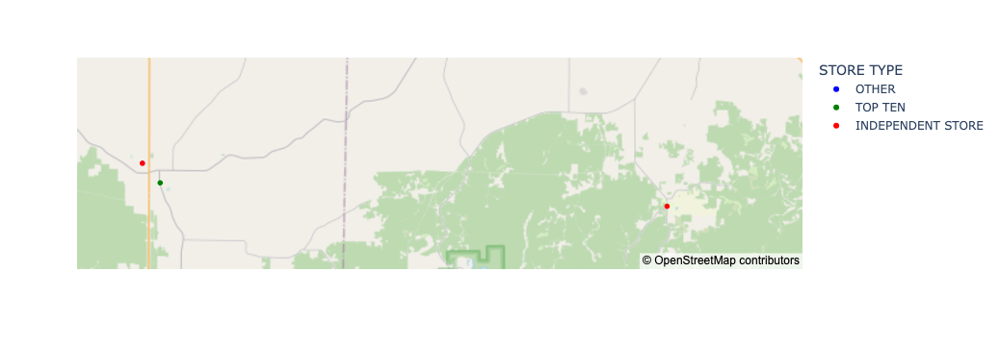

In [22]:
import plotly.express as px

# Create a scattermapbox plot
fig = px.scatter_mapbox(grocery22_gdf, lat="LATITUDE", lon="LONGITUDE", hover_data=["COMPANY"], color="STORE TYPE", color_discrete_sequence=["blue", "green", "red"], mapbox_style="open-street-map")

fig.show()

In [28]:
change_na = grocery22_gdf
change_na["PARENT NUMBER"].fillna(-1.0,inplace=True)
change_na.head()

,COMPANY,ADDRESS LINE 1,CITY,STATE,ZIPCODE,ZIP4,COUNTY CODE,AREA CODE,IDCODE,LOCATION EMPLOYEE SIZE CODE,LOCATION SALES VOLUME CODE,PRIMARY SIC CODE,SIC6_DESCRIPTIONS,PRIMARY NAICS CODE,NAICS8 DESCRIPTIONS,SIC CODE,SIC6_DESCRIPTIONS (SIC),SIC CODE 1,SIC6_DESCRIPTIONS (SIC1),SIC CODE 2,SIC6_DESCRIPTIONS(SIC2),SIC CODE 3,SIC6_DESCRIPTIONS(SIC3),SIC CODE 4,SIC6_DESCRIPTIONS(SIC4),ARCHIVE VERSION YEAR,YELLOW PAGE CODE,EMPLOYEE SIZE (5) - LOCATION,SALES VOLUME (9) - LOCATION,BUSINESS STATUS CODE,INDUSTRY SPECIFIC FIRST BYTE,YEAR ESTABLISHED,OFFICE SIZE CODE,COMPANY HOLDING STATUS,ABI,SUBSIDIARY NUMBER,PARENT NUMBER,PARENT ACTUAL EMPLOYEE SIZE,PARENT ACTUAL SALES VOLUME,PARENT EMPLOYEE SIZE CODE,PARENT SALES VOLUME CODE,SITE NUMBER,ADDRESS TYPE INDICATOR,POPULATION CODE,CENSUS TRACT,CENSUS BLOCK,LATITUDE,LONGITUDE,MATCH CODE,CBSA CODE,CBSA LEVEL,CSA CODE,FIPS CODE,GEOMETRY,STORE TYPE
0,GOMART,55 POSTAL PLZ,MORGANTOWN,WV,26508,7005.0,61.0,304,2,C,C,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,554101.0,SERVICE STATIONS-GASOLINE & OIL,554110.0,ALTERNATIVE FUELS,NaN,NaN,NaN,NaN,NaN,NaN,2022,21303.0,13.0,2482.0,2,NaN,NaN,NaN,NaN,998372387,NaN,124929449.0,50.0,389500.0,E,I,998372387.0,NaN,7,11000.0,3.0,39.594376,-79.954437,P,34060.0,2.0,390.0,54061.0,POINT (-79.95444 39.59438),OTHER
1,7-ELEVEN,485 E MAIN ST,EL CENTRO,CA,92243,2619.0,25.0,760,2,B,C,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,554101.0,SERVICE STATIONS-GASOLINE & OIL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,6.0,1273.0,2,W,NaN,NaN,NaN,495660326,NaN,5863311.0,800.0,1272634.0,H,K,495660326.0,NaN,7,11400.0,3.0,32.792679,-115.536058,0,20940.0,2.0,0.0,6025.0,POINT (-115.53606 32.79268),TOP TEN
2,EL SOL MARKET,110 W MAIN ST,WESTMORLAND,CA,92281,NaN,25.0,760,2,B,C,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,5.0,1061.0,9,NaN,NaN,NaN,NaN,519605455,NaN,-1.0,NaN,NaN,NaN,NaN,NaN,NaN,3,10200.0,1.0,33.051800,-115.581800,X,20940.0,2.0,0.0,6025.0,POINT (-115.58180 33.05180),INDEPENDENT STORE
3,COOL SPRINGS GROCERY,241 WILDWOOD ST,MORGANTOWN,WV,26505,3141.0,61.0,304,2,A,A,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,2.0,382.0,9,NaN,NaN,NaN,NaN,817953730,NaN,-1.0,NaN,NaN,NaN,NaN,NaN,NaN,7,10400.0,4.0,39.652885,-79.986398,P,34060.0,2.0,390.0,54061.0,POINT (-79.98640 39.65288),INDEPENDENT STORE
4,CIRCLE K,123 E MAIN ST,WESTMORLAND,CA,92281,NaN,25.0,760,2,B,C,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,554101.0,SERVICE STATIONS-GASOLINE & OIL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,6.0,1273.0,2,F,NaN,NaN,NaN,855113817,NaN,450720289.0,650.0,4981020.0,H,J,NaN,NaN,3,10200.0,1.0,33.051800,-115.581800,X,20940.0,2.0,0.0,6025.0,POINT (-115.58180 33.05180),TOP TEN


In [49]:
parent_dict_2 = {}
change_na.columns = change_na.columns.str.lower()

for index, row in change_na.iterrows():
    parent_num = row['parent number']
    parent_dict_2[parent_num] = parent_dict_2.get(parent_num, [])
    parent_dict_2[parent_num].append(row["company"])


In [52]:
most_common_per_parent_2 = {}
for parent_num, companies in parent_dict_2.items():
    most_common = max(set(companies), key=companies.count)
    most_common_per_parent_2[parent_num] = most_common

In [1]:
grocery22_gdf.shpae

NameError: name 'grocery22_gdf' is not defined

In [60]:
most_common_per_parent_2

'FOOD MART'

In [61]:
change_na.columns = change_na.columns.str.upper()
store_names = change_na
temp = store_names["PARENT NUMBER"] 
store_names=store_names.replace({"PARENT NUMBER": most_common_per_parent})
store_names.rename(columns={"PARENT NUMBER":"LARGEST STORE"},inplace=True)
store_names["PARENT NUMBER"] = temp
store_names.head()

,COMPANY,ADDRESS LINE 1,CITY,STATE,ZIPCODE,ZIP4,COUNTY CODE,AREA CODE,IDCODE,LOCATION EMPLOYEE SIZE CODE,LOCATION SALES VOLUME CODE,PRIMARY SIC CODE,SIC6_DESCRIPTIONS,PRIMARY NAICS CODE,NAICS8 DESCRIPTIONS,SIC CODE,SIC6_DESCRIPTIONS (SIC),SIC CODE 1,SIC6_DESCRIPTIONS (SIC1),SIC CODE 2,SIC6_DESCRIPTIONS(SIC2),SIC CODE 3,SIC6_DESCRIPTIONS(SIC3),SIC CODE 4,SIC6_DESCRIPTIONS(SIC4),ARCHIVE VERSION YEAR,YELLOW PAGE CODE,EMPLOYEE SIZE (5) - LOCATION,SALES VOLUME (9) - LOCATION,BUSINESS STATUS CODE,INDUSTRY SPECIFIC FIRST BYTE,YEAR ESTABLISHED,OFFICE SIZE CODE,COMPANY HOLDING STATUS,ABI,SUBSIDIARY NUMBER,LARGEST STORE,PARENT ACTUAL EMPLOYEE SIZE,PARENT ACTUAL SALES VOLUME,PARENT EMPLOYEE SIZE CODE,PARENT SALES VOLUME CODE,SITE NUMBER,ADDRESS TYPE INDICATOR,POPULATION CODE,CENSUS TRACT,CENSUS BLOCK,LATITUDE,LONGITUDE,MATCH CODE,CBSA CODE,CBSA LEVEL,CSA CODE,FIPS CODE,GEOMETRY,STORE TYPE,PARENT NUMBER
0,GOMART,55 POSTAL PLZ,MORGANTOWN,WV,26508,7005.0,61.0,304,2,C,C,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,554101.0,SERVICE STATIONS-GASOLINE & OIL,554110.0,ALTERNATIVE FUELS,NaN,NaN,NaN,NaN,NaN,NaN,2022,21303.0,13.0,2482.0,2,NaN,NaN,NaN,NaN,998372387,NaN,GOMART,50.0,389500.0,E,I,998372387.0,NaN,7,11000.0,3.0,39.594376,-79.954437,P,34060.0,2.0,390.0,54061.0,POINT (-79.95444 39.59438),OTHER,124929449.0
1,7-ELEVEN,485 E MAIN ST,EL CENTRO,CA,92243,2619.0,25.0,760,2,B,C,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,554101.0,SERVICE STATIONS-GASOLINE & OIL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,6.0,1273.0,2,W,NaN,NaN,NaN,495660326,NaN,7-ELEVEN,800.0,1272634.0,H,K,495660326.0,NaN,7,11400.0,3.0,32.792679,-115.536058,0,20940.0,2.0,0.0,6025.0,POINT (-115.53606 32.79268),TOP TEN,5863311.0
2,EL SOL MARKET,110 W MAIN ST,WESTMORLAND,CA,92281,NaN,25.0,760,2,B,C,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,5.0,1061.0,9,NaN,NaN,NaN,NaN,519605455,NaN,FOOD MART,NaN,NaN,NaN,NaN,NaN,NaN,3,10200.0,1.0,33.051800,-115.581800,X,20940.0,2.0,0.0,6025.0,POINT (-115.58180 33.05180),INDEPENDENT STORE,-1.0
3,COOL SPRINGS GROCERY,241 WILDWOOD ST,MORGANTOWN,WV,26505,3141.0,61.0,304,2,A,A,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,2.0,382.0,9,NaN,NaN,NaN,NaN,817953730,NaN,FOOD MART,NaN,NaN,NaN,NaN,NaN,NaN,7,10400.0,4.0,39.652885,-79.986398,P,34060.0,2.0,390.0,54061.0,POINT (-79.98640 39.65288),INDEPENDENT STORE,-1.0
4,CIRCLE K,123 E MAIN ST,WESTMORLAND,CA,92281,NaN,25.0,760,2,B,C,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,554101.0,SERVICE STATIONS-GASOLINE & OIL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,6.0,1273.0,2,F,NaN,NaN,NaN,855113817,NaN,CIRCLE K,650.0,4981020.0,H,J,NaN,NaN,3,10200.0,1.0,33.051800,-115.581800,X,20940.0,2.0,0.0,6025.0,POINT (-115.58180 33.05180),TOP TEN,450720289.0


In [92]:
no_parent = store_names.loc[store_names["STORE TYPE"]=="INDEPENDENT STORE",:]
count_no_parent = no_parent.groupby("COMPANY").count()[["CITY"]].reset_index().rename(columns={"CITY":"COUNT"})
count_no_parent.sort_values(by="COUNT",ascending=False,inplace=True)
count_no_parent.head(10)

,COMPANY,COUNT
20407,FOOD MART,177
47788,QUICK STOP,135
31893,KWIK STOP,88
47680,QUICK MART,84
18490,EXPRESS MART,83
12607,CONVENIENT FOOD MART,72
12796,CORNER MARKET,65
13139,COUNTRY STORE,63
39633,MINI MART,60
56033,STOP & SHOP,55
